# Spectrally Normalised  GAN with PyTorch

Implementation of the SNGAN architecture from scrath with PyTorch and training it on the [frog dataset](https://github.com/jonshamir/frog-dataset).

The only difference between SNGAN and DCGAN is that discriminator weights regularized by the spectral norm, which improves stability

Parameters of the models architecture and the optimizers are the same as in the original article, unless otherwise noted.

References:
- [Spectral Norm Regularization for Improving the Generalizability of Deep Learning](https://arxiv.org/pdf/1802.05957.pdf)
- [Spectral Normalization for GANs](https://arxiv.org/pdf/1802.05957.pdf)
- [deeplearing.ai GAN's specialization, C1W3](https://www.coursera.org/learn/build-basic-generative-adversarial-networks-gans/home/week/3)

In [1]:
# mount gdrive to save models
from pathlib import Path
from google.colab import drive

drive.mount('/content/gdrive')

GDRIVE = '/content/gdrive/MyDrive/neurofrogs'
WORKDIR = GDRIVE + '/sngan/'
Path(WORKDIR).mkdir(parents=True, exist_ok=True)

Mounted at /content/gdrive


In [2]:
# install the IS and the FID metrics
%%capture
%pip install pytorch-fid-wrapper
!curl https://raw.githubusercontent.com/sbarratt/inception-score-pytorch/master/inception_score.py >inception_score.py

In [3]:
import torch
from torch import nn
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
from PIL import Image
from IPython.display import clear_output
from tqdm.auto import tqdm
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['legend.fontsize'] = 14
plt.rcParams['legend.facecolor'] = 'seashell'
import os
import glob
import pickle
import time
from inception_score import inception_score
import pytorch_fid_wrapper as pfw

import warnings
warnings.simplefilter("ignore")

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
pfw.set_config(device=device)

gpu = None
if device!='cpu':
    gpu = !nvidia-smi --query-gpu=gpu_name  --format=csv,noheader
print(f'Device: {device}\n'
      f'GPU: {gpu}\n'
      f'PyTorch version: {torch.__version__}')

Device: cuda:0
GPU: ['Tesla T4']
PyTorch version: 1.9.0+cu102


# Data Loading

In [4]:
# load the frog dataset
!git clone https://github.com/jonshamir/frog-dataset.git /content/data

Cloning into '/content/data'...
remote: Enumerating objects: 53349, done.
remote: Total 53349 (delta 0), reused 0 (delta 0), pack-reused 53349
Receiving objects: 100% (53349/53349), 1.02 GiB | 40.59 MiB/s, done.
Resolving deltas: 100% (113/113), done.
Checking out files: 100% (23392/23392), done.


In [5]:
class UnlabeledDataset(torch.utils.data.Dataset):
    def __init__(self, path, transform=None):
        self.image_paths = glob.glob(path + '*.png')
        self.transform = transform

    def __getitem__(self, index):
        x = Image.open(self.image_paths[index])
        # remove alpha channel
        background = Image.new('RGBA', x.size, (255,255,255))
        x = Image.alpha_composite(background, x)
        x = x.convert('RGB')
        if self.transform is not None:
            x = self.transform(x)
        return x

    def __len__(self):
        return len(self.image_paths)

In [6]:
TRAIN_DATA_PATH = '/content/data/data-224/'
BATCH_SIZE = 256


TRANSFORM_IMG = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomPerspective(distortion_scale=0.30, p=0.5, fill=(255,255,255)),
    transforms.RandomRotation(20, fill=(255,255,255)),
    transforms.ColorJitter(brightness=0., contrast=0.1, saturation=0.3, hue=0.05),

    transforms.ToTensor(),
    transforms.Resize((64, 64)),
    transforms.GaussianBlur(kernel_size=(3, 3), sigma=0.45),
    transforms.Normalize([0.5], [0.5]),
    ])

train_data = UnlabeledDataset(path=TRAIN_DATA_PATH, transform=TRANSFORM_IMG)
train_loader = DataLoader(dataset=train_data,
                          batch_size=BATCH_SIZE,
                          shuffle=True,
                          num_workers=2
                          )

# Utils

In [7]:
# Visualization

def show_tensor_images(image_tensor, num_images=25, ax=None):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_tensor = image_tensor.detach().cpu()
    if num_images > 1:
      image_tensor = make_grid(image_tensor[:num_images], nrow=int(num_images**0.5), padding=1)
    image_tensor = image_tensor.permute(1, 2, 0).squeeze()
    if ax is None:
        ax = plt
    ax.imshow(image_tensor)
    ax.axis('off')

In [8]:
# Checkpoints

def create_checkpoint(model=None,
                      optimizer=None,
                      epoch=0,
                      filename=None,
                      directory=WORKDIR,
                      **kwargs):
    if filename is None:
        if model: 
            classname = model.__class__.__name__
        else:
            classname = 'Additional'
        filename = f'{classname}-{epoch}.pt'
    filename = directory + filename

    checkpoint = dict()
    if model:
        checkpoint['model'] = model.state_dict()
    if optimizer:
        checkpoint['optimizer'] = optimizer.state_dict()
    if epoch != 0:
        checkpoint['epoch'] = epoch
    checkpoint.update(kwargs)
    torch.save(checkpoint, filename)
    return filename


def load_checkpoint(path, model_class, train=True, **kwargs):
    checkpoint = torch.load(path)
    model = model_class(**kwargs).to(device)
    model.load_state_dict(checkpoint['model'])
    if not train:
        model.eval()
        return model
    model_optimizer = torch.optim.Adam(model.parameters())
    model_optimizer.load_state_dict(checkpoint['optimizer'])
    model.train()
    return model, model_optimizer

In [9]:
# Evaluation

def get_is_fid(generator, num_fake=len(train_data)):
    noise = torch.randn(num_fake, generator.z_dim, device=device)
    generator.eval()
    fake_images = generator(noise)
    generator.train()
    iss = inception_score(fake_images, batch_size=32, resize=True, splits=10)
    fid = pfw.fid(fake_images, real_m=REAL_M, real_s=REAL_S)
    del fake_images, noise
    torch.cuda.empty_cache()
    return iss, fid

# Load or compute inception statistics of the train dataset
filename = WORKDIR+'../dataset_inception_statistics.npz'

if os.path.isfile(filename):
    npz = np.load(filename)
    REAL_M = npz['REAL_M']
    REAL_S = npz['REAL_S']
else:
    transform = transforms.Compose([
      transforms.ToTensor(),
      transforms.Normalize([0.5], [0.5]),
    ])
    _data = UnlabeledDataset(path='/content/data/data-64/', transform=transform)
    _loader = DataLoader(dataset=_data)
    real_data = torch.vstack([i for i in _loader])
    REAL_M, REAL_S = pfw.get_stats(real_data)
    np.savez(WORKDIR+'../dataset_inception_statistics.npz', REAL_M=REAL_M, REAL_S=REAL_S)
    del real_data
    torch.cuda.empty_cache()

# Model definition

In [10]:
class Discriminator(nn.Module):
    def __init__(self, im_chan=3, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # input is (im_chan) x 64 x 64
            nn.utils.spectral_norm(
                nn.Conv2d(im_chan, hidden_dim, kernel_size=4,
                          stride=2, padding=1, bias=False)
            ),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim) x 32 x 32
            nn.utils.spectral_norm(
                nn.Conv2d(hidden_dim, hidden_dim * 2, kernel_size=4,
                          stride=2, padding=1, bias=False)
            ),
            nn.BatchNorm2d(hidden_dim * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim*2) x 16 x 16
            nn.utils.spectral_norm(
                nn.Conv2d(hidden_dim * 2, hidden_dim * 4, kernel_size=4,
                          stride=2, padding=1, bias=False)
            ),
            nn.BatchNorm2d(hidden_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim*4) x 8 x 8
            nn.utils.spectral_norm(
                nn.Conv2d(hidden_dim * 4, hidden_dim * 8, kernel_size=4,
                          stride=2, padding=1, bias=False)
            ),
            nn.BatchNorm2d(hidden_dim * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim*8) x 4 x 4
            nn.utils.spectral_norm(
                nn.Conv2d(hidden_dim * 8, 1, kernel_size=4,
                          stride=1, padding=0, bias=False)
            )
            # Linear output! 
        )

    def forward(self, input):
        return self.disc(input)

In [11]:
class Generator(nn.Module):

    def __init__(self, z_dim=100, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.gen = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( z_dim, hidden_dim * 8, kernel_size=4,
                               stride=1, padding=0, bias=False),
            nn.BatchNorm2d(hidden_dim * 8),
            nn.ReLU(True),

            # state size. (hidden_dim*8) x 4 x 4
            nn.ConvTranspose2d(hidden_dim * 8, hidden_dim * 4, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim * 4),
            nn.ReLU(True),

            # state size. (hidden_dim*4) x 8 x 8
            nn.ConvTranspose2d(hidden_dim * 4, hidden_dim * 2, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim * 2),
            nn.ReLU(True),

            # state size. (hidden_dim*2) x 16 x 16
            nn.ConvTranspose2d(hidden_dim * 2, hidden_dim, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.ReLU(True),

            # state size. (hidden_dim) x 32 x 32
            nn.ConvTranspose2d(hidden_dim, im_chan, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.Tanh()
            # state size. (im_chan) x 64 x 64
        )

    def unsqueeze_noise(self, noise):
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

In [12]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# GAN training


## Parameters

In [13]:
NDF = 64
NGF = 64
Z_DIM = 100

criterion = nn.BCEWithLogitsLoss()

lr = 0.0002
beta_1 = 0.5 
beta_2 = 0.999

np.random.seed(0)
fixed_noise = torch.Tensor(np.random.randn(16, Z_DIM)).to(device)

REAL_LABEL = 1.
FAKE_LABEL = 0.

NUM_EPOCHS = 1400
DISPLAY_STEP = 10
EVAL_STEP = 10
CHECKPOINT_STEP = 50

## Training loop

In [14]:
RESTORE = 1400

if RESTORE is None or RESTORE == 0:
    discriminator = Discriminator(hidden_dim=NDF).to(device)
    discriminator_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta_1, beta_2))
    generator = Generator(hidden_dim=NGF, z_dim=Z_DIM).to(device)
    generator_optimizer = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta_1, beta_2))
    discriminator.apply(weights_init)
    generator.apply(weights_init)
    G_losses, D_losses = [], []
    times = []
    is_scores, fid_scores = [], []
    viz_progress = []
    initial_epoch = 0
else:
    generator, generator_optimizer = load_checkpoint(WORKDIR+f'Generator-{RESTORE}.pt', Generator, hidden_dim=NGF, z_dim=Z_DIM)
    discriminator, discriminator_optimizer = load_checkpoint(WORKDIR+f'Discriminator-{RESTORE}.pt', Discriminator, hidden_dim=NDF)
    checkpoint = torch.load(WORKDIR+f'Statistics.pt')
    if checkpoint['epoch'] != RESTORE:
        print('WARNING! Epoch in statistics file does not match epoch in RESTORE')
    G_losses = checkpoint['G_losses']
    D_losses = checkpoint['D_losses']
    times = checkpoint['times']
    is_scores = checkpoint['is_scores']
    fid_scores = checkpoint['fid_scores']
    viz_progress = checkpoint['viz_progress']

    initial_epoch = RESTORE
    print(f'Restored from {RESTORE} epoch checkpoint')

Restored from 1200 epoch checkpoint


In [15]:
print("Starting Training Loop...")
# For each epoch
for epoch in range(initial_epoch+1, NUM_EPOCHS+1):
    print(f'Epoch: {epoch}')
    start = time.time()
    for i, data in enumerate(tqdm(train_loader)):
        # (1) Update discriminator
        discriminator.zero_grad()

        ## Train with all-real batch
        real = data.to(device)
        batch_size = real.size(0)

        output = discriminator(real)
        label = torch.full_like(output, REAL_LABEL)
        discriminator_real_loss = criterion(output, label)
        
        ## Train with all-fake batch
        noise = torch.randn(batch_size, Z_DIM, device=device)
        fake = generator(noise).detach()
        output = discriminator(fake)
        label = torch.full_like(output, FAKE_LABEL)
        discriminator_fake_loss = criterion(output, label)

        discriminator_loss = (discriminator_real_loss + discriminator_fake_loss) / 2
        discriminator_loss.backward()
        discriminator_optimizer.step()

        # (2) Update generator
        generator.zero_grad()
        fake = generator(noise)
        output = discriminator(fake)
        label = torch.full_like(output, REAL_LABEL)
        generator_loss = criterion(output, label)
        generator_loss.backward()
        generator_optimizer.step()

        # Save Losses for plotting later
        G_losses.append(generator_loss.item())
        D_losses.append(discriminator_loss.item())
        
    print(f'real_loss {discriminator_real_loss.item()}\t fake_loss {discriminator_fake_loss.item()}')
    print(f'Loss_D: {D_losses[-1]:.4f}\tLoss_G: {G_losses[-1]:.4f}')
    times.append(time.time() - start)
    
    if epoch % EVAL_STEP == 0:
        score = get_is_fid(generator)
        is_scores.append(score[0])
        fid_scores.append(score[1])
        viz_progress.append(generator(fixed_noise).detach().cpu())
        print(f'Evaluation results: {score}')

    if epoch % DISPLAY_STEP == 0:
        fake = generator(fixed_noise).detach().cpu()
        show_tensor_images(fake, fake.shape[0])
        plt.show()

    if (epoch % CHECKPOINT_STEP == 0 and epoch > 0) or epoch == NUM_EPOCHS:
        create_checkpoint(generator, generator_optimizer, epoch)
        create_checkpoint(discriminator, discriminator_optimizer, epoch)
        create_checkpoint(G_losses=G_losses, D_losses=D_losses, times=times,
                          epoch=epoch, is_scores=is_scores, fid_scores=fid_scores,
                          viz_progress=viz_progress,
                          filename='Statistics.pt')
        clear_output()
        print("Saved!")


Saved!


# Results

In [16]:
# Load training statistics
checkpoint = torch.load(WORKDIR+f'Statistics.pt')
G_losses = checkpoint['G_losses']
D_losses = checkpoint['D_losses']
times = checkpoint['times']
is_scores = checkpoint['is_scores']
fid_scores = checkpoint['fid_scores']
viz_progress = checkpoint['viz_progress']

eval_epochs = np.arange(10, NUM_EPOCHS+1, EVAL_STEP)

### Training statistics

In [17]:
f'{np.mean(times):0.5f} seconds per epoch'

'57.13268 seconds per epoch'

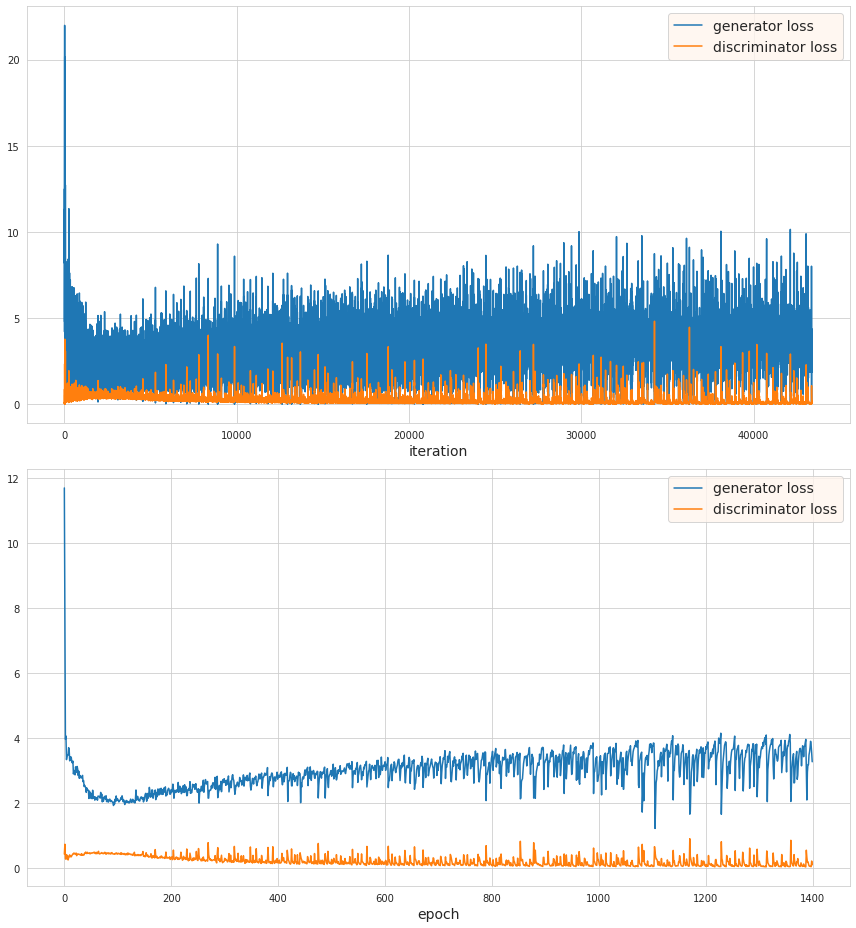

In [18]:
D_epoch_losses = np.array(D_losses).reshape(-1, 31).mean(axis=1)
G_epoch_losses = np.array(G_losses).reshape(-1, 31).mean(axis=1)

_, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 13), tight_layout=True)
ax1.plot(G_losses, label='generator loss')
ax1.plot(D_losses, label='discriminator loss')
ax1.set_xlabel('iteration')
ax1.legend();

ax2.plot(G_epoch_losses, label='generator loss')
ax2.plot(D_epoch_losses, label='discriminator loss')
ax2.set_xlabel('epoch')
ax2.legend();

After ~300 epochs discriminator loss starts to take small, close to zero values, while generator loss still grows. This means that the discriminator overcomes the generator, and stops give it a meaningful feedback. Attempt to train GAN with reduced discriminator (NDF=32) doesn't give any improvement.

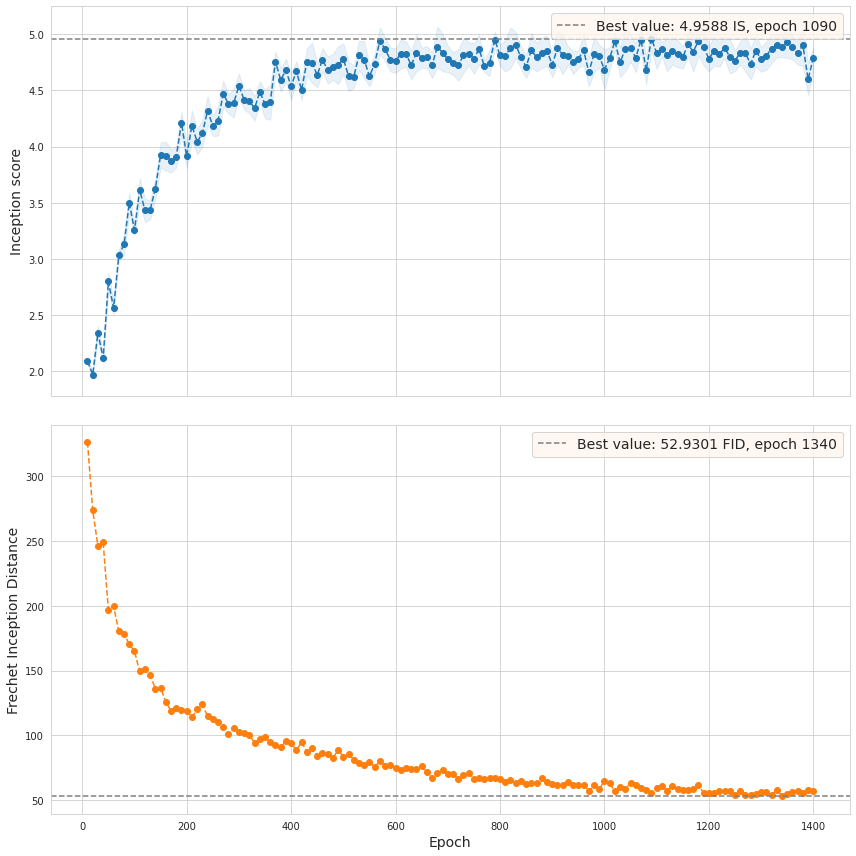

In [19]:
iss = np.array(is_scores)
iss, iss_std = iss[:, 0], iss[:, 1]
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 12), tight_layout=True, sharex=True)
ax1.plot(eval_epochs, iss, 'o--');
ax1.fill_between(eval_epochs, (iss-iss_std), (iss+iss_std), color='tab:blue', alpha=.1)
ax1.axhline(np.max(iss), linestyle='--', color='tab:gray',
            label=f"Best value: {np.max(iss):.4f} IS, epoch {eval_epochs[np.argmax(iss)]}")
ax1.legend()
ax1.set_ylabel("Inception score")
ax1.set_xlabel(' ')

ax2.plot(eval_epochs, fid_scores, 'o--', color='tab:orange')
ax2.axhline(np.min(fid_scores), linestyle='--', color='tab:gray',
            label=f"Best value: {np.min(fid_scores):.4f} FID, epoch {eval_epochs[np.argmin(fid_scores)]}")
ax2.legend()
ax2.set_ylabel("Frechet Inception Distance")
ax2.set_xlabel("Epoch");

IS was not stable (also there was an impact of the stochastic nature of scoring). While FID more monotonically improved until the end, then reach a plateau.

## Generated images

### Training animation

In [20]:
%%capture
%pip install celluloid
from celluloid import Camera
from IPython.display import HTML

Animation size has reached 21218361 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


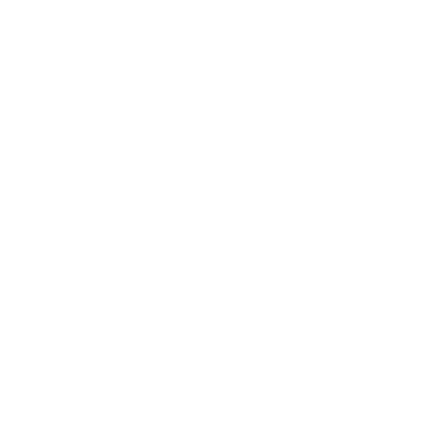

In [21]:
fig, ax1 = plt.subplots(figsize=(6, 6), tight_layout=True)
camera = Camera(fig)

for i, image_tensor in enumerate(viz_progress):
    show_tensor_images(image_tensor, num_images=16, ax=ax1)
    ax1.text(0.5, 1.01, f'Epoch {eval_epochs[i]}', transform=ax1.transAxes, fontsize=14, ha='center')
    camera.snap()
animation = camera.animate()
animation.save(WORKDIR+'training_progress.gif', writer='pillow')
HTML(animation.to_jshtml())

### Visual exploration

In [22]:
epoch_checkpoints = np.arange(400, NUM_EPOCHS+1, 200)
load_gen = lambda x: load_checkpoint(WORKDIR+f'Generator-{x}.pt', Generator, train=False, hidden_dim=NGF, z_dim=Z_DIM)

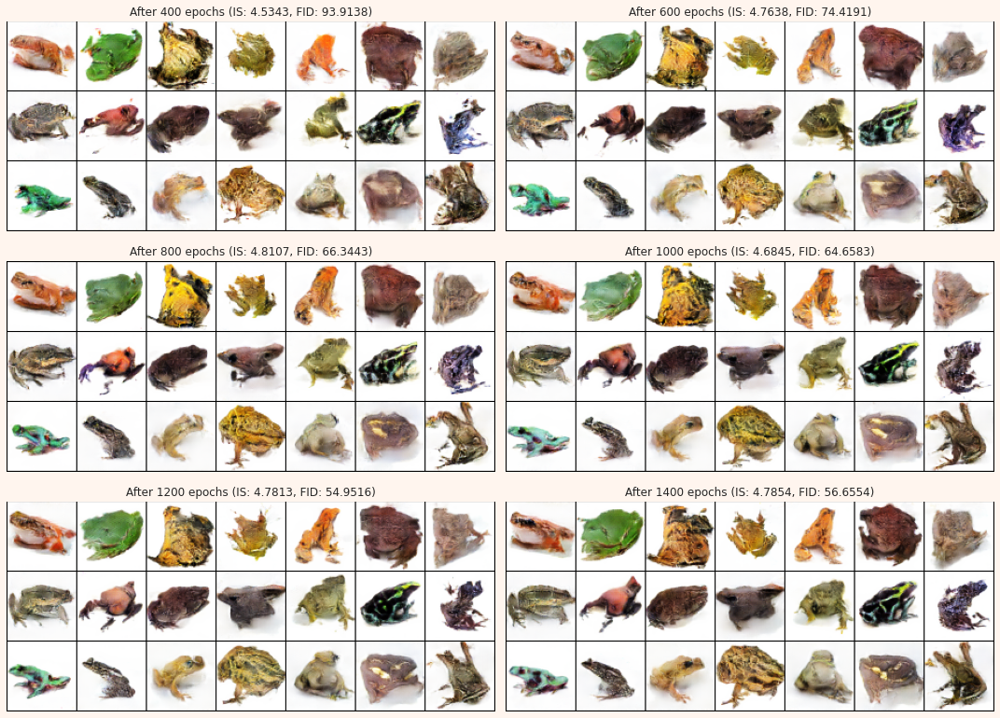

In [23]:
num_gens = len(epoch_checkpoints)
rows = (num_gens + 1)//2
fig, axs = plt.subplots(rows, 2, figsize=(15, 10/3*rows + 1), facecolor='seashell', tight_layout=True)
axs = axs.ravel()

noise = torch.randn(21, Z_DIM, device=device)

for i, epoch in enumerate(epoch_checkpoints):
    score_idx = (np.abs(eval_epochs - epoch)).argmin()
    
    gen = load_gen(epoch)
    image_tensor = gen(noise)
    show_tensor_images(image_tensor, num_images=49, ax=axs[i])
    axs[i].set_title(f'After {epoch} epochs (IS: {iss[score_idx]:.4f}, FID: {fid_scores[score_idx]:.4f})')

The generated images don't look very good.

The best FID score among checkpoints was on 1200 epoch, but visually there is no much difference between consecutive checkpoints. All images have recognizable contour, but are hardly distorted inside it with random texture smears or sometimes with checkerboard pattern. Frogs looks solid, but details, like eyes, are completly lost.

### Interpolation

In [24]:
def slerp(low, high, val):
    low_norm = low / torch.norm(low, dim=1, keepdim=True)
    high_norm = high / torch.norm(high, dim=1, keepdim=True)
    omega = torch.acos((low_norm * high_norm).sum(1))
    so = torch.sin(omega)
    res = (torch.sin((1.0-val)*omega)/so).unsqueeze(1)*low + (torch.sin(val*omega)/so).unsqueeze(1) * high
    return res

In [25]:
generator1200 = load_gen(1200)
generator1400 = load_gen(1400)

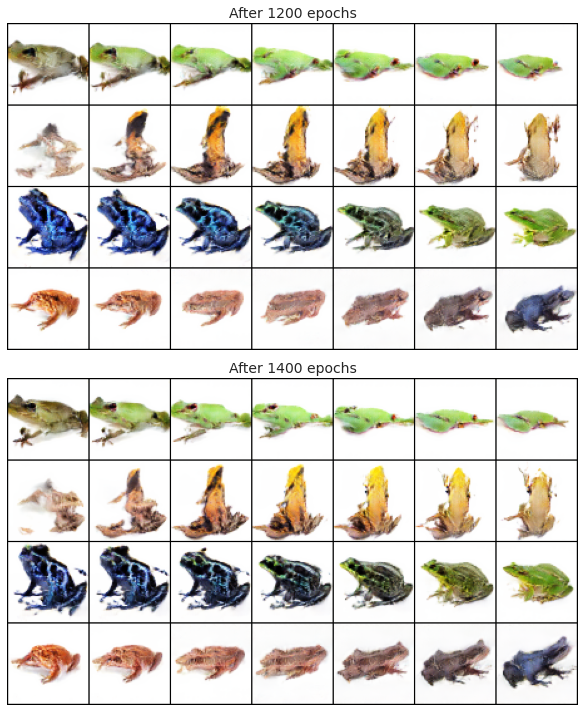

In [26]:
frog1 = torch.randn(4, Z_DIM, device=device)
frog2 = torch.randn(4, Z_DIM, device=device)

T = torch.vstack([slerp(frog1, frog2, a) for a in np.linspace(0,1,7)])
image_tensor_1200 = (generator1200(T).reshape(7, 4, 3, 64, 64)
                                   .permute(1,0,2,3,4)
                                   .reshape(28, 3, 64, 64)
                                   )
image_tensor_1400 = (generator1400(T).reshape(7, 4, 3, 64, 64)
                                   .permute(1,0,2,3,4)
                                   .reshape(28, 3, 64, 64)
                                   )

fig, axs = plt.subplots(2, 1, figsize=(12, 10), tight_layout=True)
show_tensor_images(image_tensor_1200, num_images=49, ax=axs[0])
axs[0].set_title("After 1200 epochs", fontsize=14)
show_tensor_images(image_tensor_1400, num_images=49, ax=axs[1])
axs[1].set_title("After 1400 epochs", fontsize=14);

## Discriminator insights

In [27]:
discriminator1400 = load_checkpoint(WORKDIR+'Discriminator-1400.pt',
                                   Discriminator, hidden_dim=NDF, train=False)

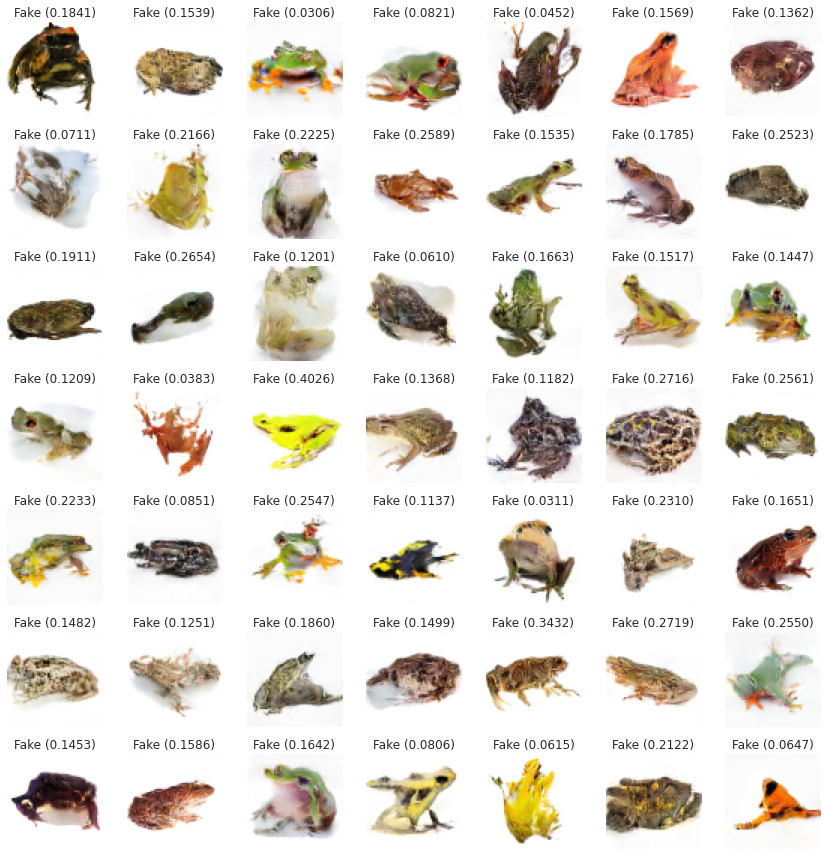

In [28]:
noise = torch.randn(49, Z_DIM, device=device)

fake_images = generator1400(noise)
probs = torch.sigmoid(discriminator1400(fake_images))
probs = probs.detach().cpu().numpy().ravel()

fig, axs = plt.subplots(7, 7, figsize=(12, 12), tight_layout=True)
axs = axs.ravel()

for i, image in enumerate(fake_images):
    pred = "Fake" if probs[i] < 0.5 else "Real"
    axs[i].set_title(f'{pred} ({probs[i]:.4f})')
    show_tensor_images(image,1, axs[i])

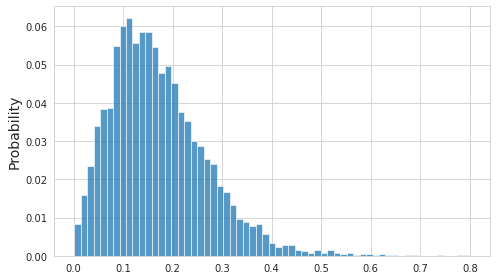

In [29]:
noise = torch.randn(7000, Z_DIM, device=device)
fake_images = generator1400(noise)
probs = torch.sigmoid(discriminator1400(fake_images))
probs = probs.detach().cpu().numpy().ravel()
del fake_images, noise
torch.cuda.empty_cache()

fig, ax = plt.subplots(figsize=(7, 4), tight_layout=True)
sns.histplot(probs, stat='probability');

Distribution isn't close to zero, mean and median are something between 0.1 and 0.2. Looks like spectral regularization gives an effect similar to soft labels (using something like 0.1 and 0.9 as ground truth)

# Summary
GAN with spectral normalization takes more time for training, but produced images still be very distorted. Images aren't better than ones by DCGAN, but, maybe more solid. 